### 1. Imports

In [1]:
# Import libraries
import warnings
warnings.filterwarnings("ignore")
import gym
import numpy as np
from stable_baselines3 import PPO, A2C, DQN
from matplotlib import pyplot as plt
import matplotlib.lines as mlines
import json
import jsbeautifier
from datetime import datetime

In [2]:
# Import classes
from rl_environment_arrival_amount_no_bool import Environment

### 2. Parameter Selection

#### Parameters for Simulation

In [3]:
number_of_regional_warehouses = 2
max_inventory_amount_regional_warehouses = 30
max_inventory_amount_central_warehouse = 60
customer_demand_per_step = [2,3,1]  # List needs one entry per regional warehouse 
simulation_length = 40
lead_time = 2
shipment_amount = [8]  # Regarding regional warehouses
with_manufacturer = True
cw_shipment_amount = 10  # Regarding central warehouse
manufacturer_prod_capacity_per_step = 10
shipment_var_cost_per_unit = 0.02
shipment_fixed_cost = .25  # Reward penalty
inventory_holding_cost_multiplier = 1 # Standard = 1; Can be lowered; Not higher that 1
cw_inventory_holding_cost_multiplier = .5
demand_fluctuation = 1
lead_time_fluctuation = 0
customer_priorities = [1, 1, 1] # List needs one entry per regional warehouse customer 

#### Parameters for Agent Training

In [4]:
algorithm = "DQN"  # "PPO", "A2C" or "DQN"
training_steps = 200000

print("-> Equals to " + str(int(training_steps/simulation_length)) + " training episodes")

-> Equals to 5000 training episodes


###### Parameters for Logging File

In [5]:
create_logfile = True
logfile_location = "./logfiles" # Can be partial or full path. Empty string for current directory

### 3. Environment Creation

###### Determine if chosen algorithm needs discrete action space

In [6]:
algorithms_that_need_single_action_value = ["DQN"]

if algorithm.upper() in algorithms_that_need_single_action_value:
    use_single_value_action_space = True
else:
    use_single_value_action_space = False

#### Creating Environment

In [7]:
env = Environment(number_of_regional_wh = number_of_regional_warehouses, 
                  rw_inventory_limit = max_inventory_amount_regional_warehouses, 
                  cw_inventory_limit = max_inventory_amount_central_warehouse,
                  demand = customer_demand_per_step,
                  sim_length = simulation_length,
                  lead_time = lead_time,
                  shipment_amount = shipment_amount,
                  manufacturer = with_manufacturer,
                  cw_shipment_amount = cw_shipment_amount,
                  mf_prod_capacity = manufacturer_prod_capacity_per_step,
                  shipment_var_cost_per_unit = shipment_var_cost_per_unit,
                  shipment_fixed_cost = shipment_fixed_cost,
                  inventory_holding_cost_multiplier = inventory_holding_cost_multiplier,
                  cw_inventory_holding_cost_multiplier = cw_inventory_holding_cost_multiplier,
                  demand_fluctuation = demand_fluctuation,
                  lead_time_fluctuation = lead_time_fluctuation,
                  use_single_value_action_space = use_single_value_action_space,
                  customer_priorities = customer_priorities
                 )

env.print_environment_information()

Simulation created with the following parameters:
________________________________________________________________________________
Simulation | Round 1
-------------------
-> Active shipments:
No active shipments

-> Warehouses:
central_warehouse ; Inventory: 20
regional_warehouse_1 ; ID: 1 ; Inventory: 10 ; Demand: 2 ; Priority: 1.0 ; Lost sales: 0
regional_warehouse_2 ; ID: 2 ; Inventory: 10 ; Demand: 3 ; Priority: 1.0 ; Lost sales: 0

-> Production plant:
manufacturer ; Production per step: 10 ; Inventory: 100
________________________________________________________________________________
Environment Information
-----------------------
-> Gym spaces:
Observation space: Dict(cw_amount_in_transit:Discrete(21), cw_inventory:Discrete(61), cw_next_arrival:Discrete(3), next_arrival:MultiDiscrete([3 3]), rw_amount_in_transit:MultiDiscrete([17 17]), rw_inventories:MultiDiscrete([31 31]))
Action space: Discrete(8)
Starting state: {'rw_inventories': array([10, 10]), 'next_arrival': array([0,

###### Initiate Logfile

In [8]:
if create_logfile:
    parameter_dict = {"number_of_regional_warehouses" : number_of_regional_warehouses,
                      "rw_inventory_limit" : max_inventory_amount_regional_warehouses,
                      "cw_inventory_limit" : max_inventory_amount_central_warehouse, "demand" : customer_demand_per_step,
                      "sim_length" : simulation_length, "lead_time" : lead_time, "shipment_amount" : shipment_amount,
                      "manufacturer" : with_manufacturer, "cw_shipment_amount" : cw_shipment_amount,
                      "mf_prod_capacity" : manufacturer_prod_capacity_per_step,
                      "shipment_var_cost_per_unit" : shipment_var_cost_per_unit, "shipment_fixed_cost" : shipment_fixed_cost,
                      "inventory_holding_cost_multiplier" : inventory_holding_cost_multiplier,
                      "cw_inventory_holding_cost_multiplier" : cw_inventory_holding_cost_multiplier,
                      "demand_fluctuation" : demand_fluctuation, "lead_time_fluctuation" : lead_time_fluctuation,
                      "use_single_value_action_space" : use_single_value_action_space,
                      "customer_priorities" : customer_priorities
                     }
    
    algorithm_dict = {"rl_model": algorithm, "num_of_training_steps": training_steps}
    json_dict = {"simulation_parameters":parameter_dict, "rl_model_training": algorithm_dict}

### 3. RL model training

###### Model Selection
PPO (Proximal Policy Optimization)
https://openai.com/blog/openai-baselines-ppo/

A2C
https://openai.com/blog/baselines-acktr-a2c/

DQN
https://openai.com/blog/openai-baselines-dqn/

In [9]:
# Choose algorithm based on user decision
if algorithm.upper() == "PPO":
    trained_model = PPO("MultiInputPolicy", env, verbose=1)
elif algorithm.upper() == "A2C":
    trained_model = A2C("MultiInputPolicy", env, verbose=1)
elif algorithm.upper() == "DQN":
    trained_model = DQN("MultiInputPolicy", env, verbose=1)
else:
    print("Model not found")
    exit()

# Start model training
trained_model.learn(total_timesteps=training_steps)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([26,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_

{'rw_inventories': array([24,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, '

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, '

{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 28, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6,

{'rw_inventories': array([21,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory'

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, '

{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2

{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_

{'rw_inventories': array([25, 17]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24, 23]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21, 17]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20, 15]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26, 19]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, '

{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, '

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, '

{'rw_inventories': array([25, 14]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22, 12]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([12,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4,

{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 19]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8

{'rw_inventories': array([23, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21, 18]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18, 23]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.31    |
|    exploration_rate | 0.901    |
| time/               |          |
|    episodes         | 52       |
|    fps              | 2128     |
|    time_elapsed     | 0        |
|    total_timesteps  | 2080     |
----------------------------------
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_tra

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([13,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory':

{'rw_inventories': array([13,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18,  4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23,  5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, '

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([25,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw

{'rw_inventories': array([17, 16]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24, 21]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22, 19]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6

{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.55    |
|    exploration_rate | 0.848    |
| time/               |          |
|    episodes         | 80       |
|    fps              | 2112     |
|    time_elapsed     | 1        |
|    total_timesteps  | 3200     |
----------------------------------
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': a

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_

{'rw_inventories': array([28,  4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([26, 23]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24, 21]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([22, 25]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27, 21]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([22, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28, 17]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([25, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([24,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 1

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next

{'rw_inventories': array([19,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([20,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 

{'rw_inventories': array([28,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'c

{'rw_inventories': array([21,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4,

{'rw_inventories': array([26,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_invento

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([27,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14,

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([12,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory':

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([10,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory'

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([10,  1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 

{'rw_inventories': array([29, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24, 12]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventor

{'rw_inventories': array([29, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27, 13]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8,

{'rw_inventories': array([18,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_

{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_

{'rw_inventories': array([23,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24,  6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory':

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory'

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10,  1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory':

{'rw_inventories': array([24,  9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory':

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'c

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arr

{'rw_inventories': array([13, 23]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([29,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory':

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18,  5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23,  1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventor

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([20,  3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, '

{'rw_inventories': array([22,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([14, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory':

{'rw_inventories': array([14, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([25,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10,

{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([25,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory'

{'rw_inventories': array([24,  8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([18, 25]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23, 23]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([22, 28]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29, 24]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28, 20]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27, 25]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 1

{'rw_inventories': array([15,  6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory

{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 14]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 19]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inve

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_nex

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_n

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory'

{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, '

{'rw_inventories': array([20, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4,

{'rw_inventories': array([24, 18]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27, 16]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, '

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory':

{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory'

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'c

{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.53    |
|    exploration_rate | 0.4      |
| time/               |          |
|    episodes         | 316      |
|    fps              | 2255     |
|    time_elapsed     | 5        |
|    total_timesteps  | 12640    |
----------------------------------
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit

{'rw_inventories': array([19,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 14,

{'rw_inventories': array([ 1, 25]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 22]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 20]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 18]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, '

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18,

{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, '

{'rw_inventories': array([28,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventor

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arr

{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory'

{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([23,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory':

{'rw_inventories': array([11,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 19]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 24]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18, 28]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inve

{'rw_inventories': array([22, 21]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20, 18]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26, 24]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24, 22]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23, 18]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29, 23]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory'

{'rw_inventories': array([26,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6

{'rw_inventories': array([20,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.34    |
|    exploration_rate | 0.308    |
| time/               |          |
|    episodes         | 364      |
|    fps              | 2256     |
|    time_elapsed     | 6        |
|    total_timesteps  | 14560    |
----------------------------------
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': ar

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_ne

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([22, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, '

{'rw_inventories': array([29,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, '

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 1

{'rw_inventories': array([23,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_ne

{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 17]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 21]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16, 19]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_a

{'rw_inventories': array([19,  1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 5, 25]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 26]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 22]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 18]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arri

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_a

{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18,

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_n

{'rw_inventories': array([10,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([20,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8

{'rw_inventories': array([18, 19]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25, 25]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24, 21]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29, 25]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28, 26]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28, 24]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'c

{'rw_inventories': array([22,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21,  5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.57    |
|    exploration_rate | 0.141    |
| time/               |          |
|    episodes         | 452      |
|    fps              | 2268     |
|    time_elapsed     | 7        |
|    total_timesteps  | 18080    |
----------------------------------
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': 

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([20,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'c

{'rw_inventories': array([29,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory'

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([24,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.61    |
|    exploration_rate | 0.111    |
| time/               |          |
|    episodes         | 468      |
|    fps              | 2275     |
|    time_elapsed     | 8        |
|    total_timesteps  | 18720    |
----------------------------------
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': arra

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_

{'rw_inventories': array([27,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory'

{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.6     |
|    exploration_rate | 0.0804   |
| time/               |          |
|    episodes         | 484      |
|    fps              | 2282     |
|    time_elapsed     | 8        |
|    total_timesteps  | 19360    |
----------------------------------
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': 

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([16,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([20,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 

{'rw_inventories': array([25,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 48, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 42, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventor

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_n

{'rw_inventories': array([19, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([14,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory'

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'c

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2,

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_a

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'c

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 24, 'cw_nex

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 15]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 18]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'c

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 16]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18,

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 

{'rw_inventories': array([27,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([22, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 

{'rw_inventories': array([ 6, 13]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 16]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 22]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21, 20]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18, 18]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory'

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, '

{'rw_inventories': array([17, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8

{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.35    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 596      |
|    fps              | 2300     |
|    time_elapsed     | 10       |
|    total_timesteps  | 23840    |
----------------------------------
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': arr

{'rw_inventories': array([24,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory':

{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'c

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, '

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([25, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.31    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 620      |
|    fps              | 2306     |
|    time_elapsed     | 10       |
|    total_timesteps  | 24800    |
----------------------------------
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': ar

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'c

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([22,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 

{'rw_inventories': array([24, 20]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21, 26]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([20, 27]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18, 26]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17, 23]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23, 21]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_invent

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([14,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([28,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21,  8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'c

{'rw_inventories': array([22,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([22,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, '

{'rw_inventories': array([5, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([20,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 

{'rw_inventories': array([29, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27, 14]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2,

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'c

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 36, 'cw_

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_n

{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 0, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 

{'rw_inventories': array([18,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([24,  3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory':

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 20

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, '

{'rw_inventories': array([16, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21, 18]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20, 15]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17, 21]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23, 26]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22, 28]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inve

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'c

{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_invent

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([28,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([29,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, '

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, '

{'rw_inventories': array([25,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0

{'rw_inventories': array([13, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, '

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([21,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 48, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 58, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory'

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([20,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10,

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([28,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([29,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10,

{'rw_inventories': array([18, 18]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17, 22]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 19]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19, 23]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18, 28]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16, 26]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'c

{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 

{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 

{'rw_inventories': array([ 9, 20]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 17]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24,  3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 

{'rw_inventories': array([29,  1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventor

{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, '

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_

{'rw_inventories': array([19,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.06    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 884      |
|    fps              | 2335     |
|    time_elapsed     | 15       |
|    total_timesteps  | 35360    |
----------------------------------
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': a

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_

{'rw_inventories': array([15,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([22,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([21,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14,

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventor

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_n

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory'

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory':

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arr

{'rw_inventories': array([27,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_invent

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival

{'rw_inventories': array([16, 19]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 23]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 19]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18, 25]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16, 22]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 19]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw

{'rw_inventories': array([18,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, '

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory'

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_ne

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([24, 16]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25, 18]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([12,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'c

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([26,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([20,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 15]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 20]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20, 26]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19, 22]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17, 18]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory'

{'rw_inventories': array([24, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16,

{'rw_inventories': array([19,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([29, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inven

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0,

{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([20,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 19]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory':

{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_n

{'rw_inventories': array([25, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22, 17]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.34    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1056     |
|    fps              | 2361     |
|    time_elapsed     | 17       |
|    total_timesteps  | 42240    |
----------------------------------
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transi

{'rw_inventories': array([ 0, 20]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 22]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 26]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 28]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 25]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inven

{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.27    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1064     |
|    fps              | 2362     |
|    time_elapsed     | 18       |
|    total_timesteps  | 42560    |
----------------------------------
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': ar

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([26,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([22,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 

{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([29,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'c

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 14]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 19]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2,

{'rw_inventories': array([25,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 58, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 46, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventor

{'rw_inventories': array([22,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([28,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventor

{'rw_inventories': array([26,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_

{'rw_inventories': array([26, 20]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29, 24]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([26, 20]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27, 26]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([24, 24]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([23, 26]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4,

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'c

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, '

{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'c

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory':

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arr

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_

{'rw_inventories': array([20,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 

{'rw_inventories': array([28,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29,  3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -4.44    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1180     |
|    fps              | 2343     |
|    time_elapsed     | 20       |
|    total_timesteps  | 47200    |
----------------------------------
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit':

{'rw_inventories': array([22,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, '

{'rw_inventories': array([25, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([22,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([21,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0,

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 16, 'cw_ne

{'rw_inventories': array([21,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_invento

{'rw_inventories': array([24, 14]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([22, 20]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([23,  7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 

{'rw_inventories': array([10, 12]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 18]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 13]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([19, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14,

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_n

{'rw_inventories': array([27,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([29,  3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inven

{'rw_inventories': array([25,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([26,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([29,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([28, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([27,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0,

{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, '

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_a

{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([24,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([27,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([28,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inven

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'c

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12,

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriva

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_ar

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_nex

{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_nex

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 56, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_ne

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next

{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 46, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next

{'rw_inventories': array([ 0, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, '

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_ne

{'rw_inventories': array([ 0, 21]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 19]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'c

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_n

{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_nex

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_nex

{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 38

{'rw_inventories': array([ 0, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 19]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 23]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory':

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next

{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_ne

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([ 0, 14]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 19]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_ar

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 

{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'c

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_nex

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 48, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 58, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 

{'rw_inventories': array([ 0, 28]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 26]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 24]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 38, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 20]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 24]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 50, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 27]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventor

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([ 2, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28,

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 40, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_

{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 48, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 58, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 56, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_n

{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 36, 'cw_ne

{'rw_inventories': array([ 5, 20]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 26]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 22]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 18]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory'

{'rw_inventories': array([2, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 56, 'cw_ne

{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_

{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 19]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22,

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([ 5, 23]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 21]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 27]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 24]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 20]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 24]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([ 0, 22]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 26]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 26]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 22]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 20]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 25]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28

{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([ 7, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 38, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 30, '

{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 56, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory'

{'rw_inventories': array([ 1, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_ar

{'rw_inventories': array([ 0, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2

{'rw_inventories': array([ 4, 16]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory':

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60,

{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_n

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_nex

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 22]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 27]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_in

{'rw_inventories': array([ 0, 22]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 27]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 56, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 28]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 26]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 22]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 27]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_invent

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 48, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 58, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -9.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1416     |
|    fps              | 1428     |
|    time_elapsed     | 39       |
|    total_timesteps  | 56640    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00792  |
|    n_updates        | 1659     |
----------------------------------
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20,

{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'c

{'rw_inventories': array([ 0, 18]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 56, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 56, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_ne

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 36, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 28, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw

{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next

{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_

{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_nex

{'rw_inventories': array([ 3, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 

{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_ar

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'c

{'rw_inventories': array([14,  4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 56, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 56, '

{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_

{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_ne

{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([18,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 56

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_

{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_

{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_nex

{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_

{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_ar

{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'c

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_nex

{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 24, 'cw_nex

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_n

{'rw_inventories': array([ 1, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_n

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_ar

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival'

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_n

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_ar

{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_a

{'rw_inventories': array([10,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'c

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_ar

{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_a

{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_nex

{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_ar

{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 18, 'cw_ne

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_n

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'c

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_a

{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2

{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_ar

{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_nex

{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 36, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 38, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48,

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 36, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -6.51    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1544     |
|    fps              | 1129     |
|    time_elapsed     | 54       |
|    total_timesteps  | 61760    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0239   |
|    n_updates        

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 54, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 36, 'cw_ne

{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_n

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_

{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'c

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_ar

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_

{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 54, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 36, 'cw_n

{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_nex

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_

{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_nex

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next

{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 38, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 58, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 58, 'cw_ne

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 56, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 28, 'cw_nex

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 38, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 22, 'cw_n

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 24, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_a

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next

{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 40, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 40, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_nex

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 38, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 22, 'cw_next_

{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_n

{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_

{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'c

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'c

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_nex

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_a

{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next

{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 38, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_next

{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_ne

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 56, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 56, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'c

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'c

{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_a

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_ne

{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_a

{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival'

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next

{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival'

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_

{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arriva

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_ar

{'rw_inventories': array([12,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_ar

{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arr

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_ar

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 36, 'cw_

{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 26, 'cw_

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 50, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 50, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_a

{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 28, 'cw_n

{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_ne

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arri

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arriv

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 28, 'cw_next

{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 26, 'cw_

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 36, 'cw_

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_n

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arriva

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_

{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_nex

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_ne

{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 44, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_nex

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_

{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 

{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_ne

{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([ 1, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 44, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 46, 'cw_next

{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 58, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 58, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 58, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 52, '

{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean    

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_a

{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_ne

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival'

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -6.08    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1756     |
|    fps              | 851      |
|    time_elapsed     | 82    

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival'

{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 34, 'cw_nex

{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 42, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 30, 'c

{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_

{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 48, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 58, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 50, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_

{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 52, 

{'rw_inventories': array([8, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 38, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 40, '

{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_ne

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 34, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_nex

{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'c

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -5.33    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1792     |
|    fps              | 824      |
|    time_elapsed     | 86      

{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_ar

{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 46, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -5.23    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1796     |
|    fps              | 822      |
|    time_elapsed     

{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 46, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 38, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 50, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw

{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -5.05    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1800     |
|    fps              | 820      |
|    time_elapsed     | 8

{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arriva

{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -5.04    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1804     |
|    fps              | 817      |
|    time_elapsed     | 88   

{'rw_inventories': array([1, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arri

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival'

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 32, 'cw_ne

{'rw_inventories': array([1, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, '

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival'

{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20,

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 5, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 40, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 32, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 

{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 38, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48, 'cw

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -3.64    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1844     |
|    fps              | 792      |
|    time_elapsed     | 93       |
|    total_timesteps  | 73760    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00911  |
|    n_updates        | 5939     |
----------------------------------
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_

{'rw_inventories': array([ 4, 14]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 38, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -3.64    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1848     |
|    fps              | 790      |
|    time_elapsed

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 54, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 38, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 40, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -3.51    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1852     |
|    fps              | 788      |
|    time_elapsed     

{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_

{'rw_inventories': array([1, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 52, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_nex

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 36, 'c

{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 50, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 52, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arr

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_ar

{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arri

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw

{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_nex

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'c

{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 48, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 40, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 32, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 36, '

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_

{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_nex

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 36, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 46, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 46, 'cw_nex

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -2.82    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1888     |
|    fps              | 770      |
|    time_elapsed     | 98       |
|    total_timesteps  | 75520    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0164   |
|    n_updates        | 6379     |
----------------------------------
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival'

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival'

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 22, 'cw_n

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 34, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'c

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arriva

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_ar

{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival'

{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 60, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 52, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 44, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 44, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 54, 'cw_next_

{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 28, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 38, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 40, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 42, 'cw_nex

{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_ne

{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_ar

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_

{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 24, 'c

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw

{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arriva

{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arri

{'rw_inventories': array([ 0, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next

{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_ne

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arri

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_

{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_

{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -3.39    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1972     |
|    fps              | 736      |
|    time_elapsed     | 107      |
|    total_timesteps  | 78880    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0118   |
|    n_updates        | 7

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_n

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arri

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_nex

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 10, 

{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arr

{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -3.55    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1996     |
|    fps              | 729      |
|    time_elapsed     | 109 

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, '

{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, '

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_

{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([2, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_ar

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, '

{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([ 0, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -3.22    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2024     |
|    fps              | 721      |
|    time_elapsed     |

{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'c

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arriva

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -3.21    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2036     |
|    fps              | 718      |
|    time_elapsed     | 1

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arriva

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -2.87    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2048     |
|    fps              | 714      |
|    time_elapsed     | 114    

{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arr

{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -2.77    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2052     |
|    fps              | 713      |
|    time_elapsed     | 115      |
|    total_timesteps  | 82080    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0461   |
|    n_updates        | 8019     |
----------------------------------
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([ 0, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_ne

{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival

{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriva

{'rw_inventories': array([17,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_

{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arriva

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([1, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival

{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arriva

{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_n

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_a

{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arri

{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next

{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'c

{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_ar

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arri

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_ne

{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([14,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([1, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arr

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arriv

{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'c

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arriva

{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 22, 'cw_nex

{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arri

{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -2.34    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2212     |
|    fps              | 667      |
|    time_elapsed     | 132      |
|    total_timesteps  | 88480    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0126   |
|    n_updates        | 9619     |
----------------------------------
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_ar

{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_ar

{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arri

{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -2.18    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2264     |
|    fps              | 655      |
|    time_elapsed     | 13

{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_

{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | -1.91    |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2292     |
|    fps              | 640      |
|    time_elapsed     | 143 

{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([1, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arriva

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arriva

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 

{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriva

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([ 2, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'c

{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([10, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 

{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 

{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arr

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'c

{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'c

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_ar

{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, '

{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 0, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arriv

{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arriva

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, '

{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_

{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_ar

{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arriv

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arriv

{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arriva

{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arriva

{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arriv

{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, '

{'rw_inventories': array([ 0, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next

{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_ne

{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 21]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'c

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 17]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'c

{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 16]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 20]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 18]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2,

{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([ 5, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'c

{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 15]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, '

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'c

{'rw_inventories': array([11,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 30, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 1

{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_ar

{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([13,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0,

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([9, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_n

{'rw_inventories': array([ 1, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 3, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arr

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([ 1, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4,

{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 12, 'cw_next

{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 2.78     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2588     |
|    fps              | 542      |
|    time_elapsed     | 1

{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 19]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 17]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arri

{'rw_inventories': array([ 6, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'c

{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_

{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'c

{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 1, 16]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, '

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'c

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.23     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2636     |
|    fps              | 533      |
|    time_elapsed     | 197      |
|    total_timesteps  | 105440   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0247   |
|    n_updates        | 1

{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.21     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2640     |
|    fps              | 532      |
|    time_elapsed     | 198      |
|    total_timesteps  | 105600   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00942  |
|    n_updates        | 13899    |
----------------------------------
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw

{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4,

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_

{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.23     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2652     |
|    fps              | 530      |
|    time_elapsed     | 200   

{'rw_inventories': array([1, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([14,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([22,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([26,  9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory

{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 

{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([0, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_ar

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arri

{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 19]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arri

{'rw_inventories': array([1, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.43     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2688     |
|    fps              | 519      |
|    time_elapsed     | 206  

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 15]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'c

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'c

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.45     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2704     |
|    fps              | 515      |
|    time_elapsed     | 209      |
|    total_timesteps  | 108160   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0116   |
|    n_updates        | 1

{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([ 3, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.48     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2708     |
|    fps              | 515      |
|    time_elapsed     | 210      |
|    total_timesteps  | 108320   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0139   |
|    n_updates        | 14579    |
----------------------------------
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.51     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2716     |
|    fps              | 512      |
|    time_elapsed     | 211      |
|    total_timesteps  | 108640   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0132   |
|    n_updates        | 1

{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, '

{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([ 9, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([1, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next

{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_nex

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([11, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14

{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      |

{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.39     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2776     |
|    fps              | 491      |
|    time_elapsed     | 226      |
|    total_timesteps  | 111040   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0315   |
|    n_updates   

{'rw_inventories': array([13,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([20, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12

{'rw_inventories': array([16, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 

{'rw_inventories': array([ 2, 18]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 20]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0

{'rw_inventories': array([ 2, 19]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 16]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 18]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory':

{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 14]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([1, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'c

{'rw_inventories': array([ 7, 27]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 24]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 22]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 18]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12,

{'rw_inventories': array([14, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'c

{'rw_inventories': array([ 4, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw

{'rw_inventories': array([ 3, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([10,  8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([10, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 18]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 16]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 22]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, '

{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next

{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, '

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([16,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([15,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6,

{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_

{'rw_inventories': array([ 5, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'c

{'rw_inventories': array([9, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6,

{'rw_inventories': array([ 8, 15]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 

{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, '

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_ne

{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, '

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([15,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2

{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 2.82     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2864     |
|    fps              | 472      |
|    time_elapsed     |

{'rw_inventories': array([ 7, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, '

{'rw_inventories': array([14,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([15,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8

{'rw_inventories': array([14, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, '

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'c

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 17]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 3, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'c

{'rw_inventories': array([15, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 

{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 

{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'c

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([10,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'c

{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([12,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'c

{'rw_inventories': array([11,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'c

{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 5, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 

{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 4, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, '

{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([12, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 3, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_

{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 5, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, '

{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([ 7, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([ 3, 14]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0,

{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 

{'rw_inventories': array([17, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'c

{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 15]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 21]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([ 6, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, '

{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'c

{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([ 6, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 

{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'c

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 

{'rw_inventories': array([13, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.48     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3056     |
|    fps              | 454      |
|    time_elapsed   

{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([ 1, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([12, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([16,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 

{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 

{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_a

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([11,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.55     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3128     |
|    fps              | 452      |
|    time_elapsed     | 276      |
|    total_timesteps  | 125120   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0463   |
|    n_updates        | 18779    |
----------------------------------
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, '

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, '

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_ne

{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 4, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0,

{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 

{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 3, 18]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 24]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 

{'rw_inventories': array([1, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, '

{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([9, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([19, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, '

{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'c

{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_

{'rw_inventories': array([13,  7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12

{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([ 2, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([11,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([13,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([19,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([24,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([23,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([22, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([20, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 9, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_n

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 7, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([9, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([14,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw

{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'c

{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([ 4, 15]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14

{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14,

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.55     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3296     |
|    fps              | 449      |
|    time_elapsed     | 293      |
|    total_timesteps  | 131840   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0105   |
|    n_updates        | 20459    |
----------------------------------
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([14,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 

{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next

{'rw_inventories': array([ 3, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 28, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12,

{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_ne

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, '

{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_nex

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_nex

{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 2, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([18, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([11,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'c

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([ 7, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_ar

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([10,  5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([ 5, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.57     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3412     |
|    fps              | 446      |
|    time_elapsed     | 305      |
|    total_timesteps  | 136480   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0132   |
|    n_updates        | 21619    |
----------------------------------
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([ 6, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 

{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([ 6, 18]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 19]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 17]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0,

{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_

{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([10,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([ 7, 18]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 24]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 22]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 

{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_

{'rw_inventories': array([ 3, 14]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 17]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 22]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 18]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 

{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 19]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 16]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.65     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3444     |
|    fps              | 444      |
|    time_elapsed     | 309      |
|    total_timesteps  | 137760   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0162   |
|    n_updates      

{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.69     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3448     |
|    fps              | 444      |
|    time_elapsed     

{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'c

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([16,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([20,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'c

{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 7, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_ne

{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'c

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'c

{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw

{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 17]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 22]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 16]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 

{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([ 4, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([18, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6

{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([14, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, '

{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, '

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_

{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_n

{'rw_inventories': array([16, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 

{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.64     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3508     |
|    fps              | 437      |
|    time_elapsed     |

{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([19, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 

{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next

{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([19,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 

{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.6      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3536     |
|    fps              | 435      |
|    time_elapsed     | 

{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 16]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'c

{'rw_inventories': array([14, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 16]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.55     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3548     |
|    fps              | 433      |
|    time_elapsed     

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 9, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([ 5, 17]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 21]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([ 6, 17]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw

{'rw_inventories': array([ 6, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 9, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([ 6, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, '

{'rw_inventories': array([ 7, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'c

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 16]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, '

{'rw_inventories': array([ 4, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 18]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 15]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 16]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, '

{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 24, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'c

{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'c

{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, '

{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 5, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'c

{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([ 2, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([ 8, 18]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 23]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 21]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 19]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([ 5, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 16]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 1, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 

{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 17]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 23]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, '

{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'c

{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 3, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_

{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([10,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 

{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([ 8, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 20, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 16]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0,

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_ne

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 4, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, '

{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, '

{'rw_inventories': array([ 7, 14]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 8, 26]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 24]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 21]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 17]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14

{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, '

{'rw_inventories': array([ 8, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, '

{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 3, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 

{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([12, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'c

{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 17]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([ 2, 20]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 18]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory':

{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw

{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([15,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([12,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'c

{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw

{'rw_inventories': array([10, 27]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 23]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 21]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 19]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'c

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'c

{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next

{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([0, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_nex

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([12, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 1, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([ 9, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'c

{'rw_inventories': array([ 7, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([16, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw

{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.68     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3816     |
|    fps              | 422      |
|    time_elapsed     | 361      |
|    total_timesteps  | 152640   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00771  |
|    n_updates        | 25659    |
----------------------------------
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next

{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw

{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, '

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 8, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.8      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3832     |
|    fps              | 421      |
|    time_elapsed     | 

{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([11,  8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([21, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 

{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, '

{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, '

{'rw_inventories': array([ 7, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([ 4, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 26, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 26, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 28, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 20, 'c

{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.85     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3864     |
|    fps              | 420      |
|    time_elapsed     | 367

{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'c

{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_ne

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([15,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([15,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([11,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 6, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10,

{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw

{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_n

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'c

{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 17]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, '

{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 

{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 

{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([12, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([12,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 6, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 

{'rw_inventories': array([15, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, '

{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([17, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([ 3, 16]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw

{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.57     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3988     |
|    fps              | 416      |
|    time_elapsed     | 383      |
|    total_timesteps  | 159520   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00751  |
|    n_updates        

{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw

{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'c

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_

{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([11,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 6, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, '

{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([11,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 

{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'c

{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_n

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 6, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, '

{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw

{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'c

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'c

{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 6, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 0, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 

{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 16]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 1, 15]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0,

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'c

{'rw_inventories': array([10,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([15, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([ 5, 18]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 14]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 18]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 

{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 8, '

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 1, 17]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([ 2, 17]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0

{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0,

{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10,

{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, '

{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_ne

{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([11,  8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 18, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 3, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 17]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, '

{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_a

{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([1, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 5, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arri

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([ 3, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'c

{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_

{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw

{'rw_inventories': array([ 4, 15]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, '

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 1, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_ne

{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([15,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0,

{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([ 6, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_n

{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([ 2, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 3, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([ 1, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, '

{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([0, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.77     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4292     |
|    fps              | 405      |
|    time_elapsed     |

{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  1]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([17,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2

{'rw_inventories': array([1, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw

{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([1, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, '

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'c

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 22, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'c

{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, '

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([ 8, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([ 1, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'c

{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw

{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 13]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.93     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4392     |
|    fps              | 401      |
|    time_elapsed     |

{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_n

{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw

{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([ 6, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_n

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 7, 20]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw

{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 

{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_n

{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_nex

{'rw_inventories': array([11,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([14,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'c

{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, '

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_ne

{'rw_inventories': array([ 2, 17]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 15]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 24, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_

{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 26, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 18, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_ar

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_ne

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arr

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([18,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([11, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next

{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4   

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_

{'rw_inventories': array([ 2, 13]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_ar

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 13]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'c

{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 15]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_

{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw

{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_ne

{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 7, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([ 1, 14]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_nex

{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, '

{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([6, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([17,  0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'c

{'rw_inventories': array([11,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_n

{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 16, 'cw_nex

{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([3, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_nex

{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.1      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4564     |
|    fps              | 393      |
|    time_elapsed     | 46

{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.22     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4580     |
|    fps              | 392      |
|    time_elapsed     | 466      |
|    total_timesteps  | 183200   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0106   |
|    n_updates        | 33299    |
----------------------------------
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.21     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4584     |
|    fps              | 392      |
|    time_elapsed     | 467      |
|    total_timesteps  | 183360   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00811  |
|    n_updates        | 33339    |
----------------------------------
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_ne

{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 14]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 19]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, '

{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_

{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'c

{'rw_inventories': array([10,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.21     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4596     |
|    fps              | 391      |
|    time_elapsed     |

{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([6, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_n

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_nex

{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([9, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([16,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 

{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([13,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, '

{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.21     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4620     |
|    fps              | 390      |
|    time_elapsed     | 472      |
|    total_timesteps  | 184800   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0558   |
|    n_updates        | 

{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.22     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4628     |
|    fps              | 390      |
|    time_elapsed     | 47

{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([9, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_

{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arriv

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 6, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next

{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([2, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_n

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 3, 16]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 14]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, '

{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_

{'rw_inventories': array([12,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([19,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([16,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([15,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, '

{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 2, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([17, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([13, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([8, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 10, 'cw_ne

{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 12]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 18]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_

{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 1, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'c

{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_nex

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([2, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 0, 12]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 17]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10,  1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([4, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([1, 1]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_ar

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([14,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'c

{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 2, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_

{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([3, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_a

{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([ 6, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arri

{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 3, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_

{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 2, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([1, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([7, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 

{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 4, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.24     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4820     |
|    fps              | 386      |
|    time_elapsed     

{'rw_inventories': array([ 8, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([1, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([3, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([18,  8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([16,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.26     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4828     |
|    fps              | 386      |
|    time_elapsed    

{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([11,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([10,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_

{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 12]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([ 9, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 9]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next

{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_nex

{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([3, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 14]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_

{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.21     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4856     |
|    fps              | 385      |
|    time_elapsed     | 503 

{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_n

{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([ 1, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arri

{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([6, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 1]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 5, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([11,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([11, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 7, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_a

{'rw_inventories': array([0, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 4, 12]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_

{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([1, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([16,  0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_a

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([16, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_

{'rw_inventories': array([ 0, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([4, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 1, 11]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([0, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 6]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.13  

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([14,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([14, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_nex

{'rw_inventories': array([9, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([13,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([3, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_ne

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([0, 3]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([11, 16]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 3, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 7]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 6]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([11,  1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([ 4, 10]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 7]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([7, 9]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([12,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_ne

{'rw_inventories': array([ 0, 11]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 3, 10]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 7, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_n

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([11,  2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([3, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_nex

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([5, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_nex

{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 4.05     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4948     |
|    fps              | 383      |
|    time_elapsed     | 516 

{'rw_inventories': array([ 7, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_ar

{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([1, 4]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([0, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arriv

{'rw_inventories': array([3, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arr

{'rw_inventories': array([12,  1]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 8]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_ne

{'rw_inventories': array([ 6, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([ 2, 10]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_

{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([2, 5]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([ 9, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_a

{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([ 0, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([16, 15]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([15, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([10,  3]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_n

{'rw_inventories': array([11,  8]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 12]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 0, 10]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([16,  8]), 'cw_inventory': 0, 'cw

{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 7]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([3, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next

{'rw_inventories': array([5, 7]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40       |
|    ep_rew_mean      | 3.98     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4972     |
|    fps              | 382      |
|    time_elapsed     | 519    

{'rw_inventories': array([ 6, 10]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([13,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([12,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([3, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 14, 'cw_ne

{'rw_inventories': array([9, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11,  5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([2, 3]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 9]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 14, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_a

{'rw_inventories': array([0, 2]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 0]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 4]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_a

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([ 8, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 7]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 5]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 9]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([10,  6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_ne

{'rw_inventories': array([8, 7]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 3]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([3, 8]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([5, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([2, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([0, 4]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([5, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_a

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([3, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([7, 3]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 16, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 8]), 'next_arrival': array([2, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_ar

{'rw_inventories': array([8, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([11,  4]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([14, 14]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next

{'rw_inventories': array([0, 8]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 6]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([4, 2]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 8, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 6]), 'next_arrival': array([1, 2]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 4]), 'next_arrival': array([0, 1]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 10, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 8]), 'next_arrival': array([2, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 2, 'cw_next_arr

{'rw_inventories': array([9, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 10, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([4, 0]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([1, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 6, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([0, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 6, 'cw_next

{'rw_inventories': array([9, 3]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 9]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([12, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10, 11]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([6, 5]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([6, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 6]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([11, 10]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([10,  8]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([9, 5]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([7, 1]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 2, 'cw_next_

{'rw_inventories': array([11, 13]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
{'rw_inventories': array([2, 6]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([8, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_ar

{'rw_inventories': array([4, 7]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next_arrival': 1, 'cw_amount_in_transit': 20}
{'rw_inventories': array([9, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 6, 'cw_next_arrival': 1, 'cw_amount_in_transit': 10}
{'rw_inventories': array([8, 1]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([ 8, 16]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([6, 7]), 'next_arrival': array([1, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 0, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([7, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
{'rw_inventories': array([5, 3]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_ar

###### Learning Curve

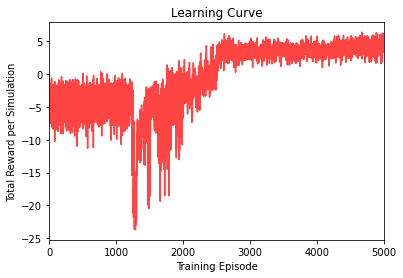

In [10]:
# Plot learning curve
plt.rcParams["figure.figsize"] = (10, 5)
plt.plot(env.total_reward, color="#FF4444")
plt.title("Learning Curve")
plt.xlim(0, len(env.total_reward))
plt.ylabel("Total Reward per Simulation")
plt.xlabel("Training Episode")
plt.show()

if create_logfile:
    json_dict["rl_model_training"]["training_rewards"] = env.total_reward

# Print used data if True
if False:
    print("Total Rewards:", env.total_reward)

### 4. Run simulation

In [11]:
# Convert actions for graphs
def convert_to_marker_pos(action):
    return_list = []
    i = 0
    for entry in action:
        if entry != 0:
            return_list.append(i)
        i += 1
    return return_list


# Graph data
cw_inventory_level, cw_actions = [], []
inventory_levels, actions = {}, {}
manufacturer_inventory = []

for rw_id in env.simulation.get_regional_warehouses():
    inventory_levels[rw_id] = []
    actions[rw_id] = []

In [12]:
# Reset environment for simulation
state = env.reset()
done = False

# Run simulation with model
while not done:
    action, _states = trained_model.predict(state) 
    state, reward, done, info = env.step(action)
    
    # For Graph
    i = 1
    for inv in info["RW Invs:"]:
        inventory_levels[i].append(inv)
        i += 1

    i = 1
    for act in info["Action:"][0:len(env.simulation.get_regional_warehouses())]:
        actions[i].append(act)
        i += 1
    
    try:
        cw_inventory_level.append(info["CW Inv:"])
        cw_actions.append(info["Action:"][-1])
        manufacturer_inventory.append(info["Manufacturer:"])
    except:
        pass
    
    # print(env.simulation.print_state())
    for i in info:
        print(i, info[i], end=" | ")
    print()
    
print("\n", env.evaluation_parameters())

{'rw_inventories': array([8, 6]), 'next_arrival': array([0, 0]), 'rw_amount_in_transit': array([0, 0]), 'cw_inventory': 20, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
Round: 1 | RW Invs: [8, 6] | Shipments [0, 0] | Action: [0, 0, 0] | Reward: 0.09 | CW Inv: 20 | Manufacturer: 100 | 
{'rw_inventories': array([6, 2]), 'next_arrival': array([0, 2]), 'rw_amount_in_transit': array([0, 8]), 'cw_inventory': 12, 'cw_next_arrival': 0, 'cw_amount_in_transit': 0}
Round: 2 | RW Invs: [6, 2] | Shipments [0, 8] | Action: [0, 1, 0] | Reward: 0.03 | CW Inv: 12 | Manufacturer: 100 | 
{'rw_inventories': array([4, 0]), 'next_arrival': array([2, 1]), 'rw_amount_in_transit': array([8, 8]), 'cw_inventory': 4, 'cw_next_arrival': 2, 'cw_amount_in_transit': 10}
Round: 3 | RW Invs: [4, 0] | Shipments [8, 8] | Action: [1, 0, 1] | Reward: -0.37 | CW Inv: 4 | Manufacturer: 90 | 
{'rw_inventories': array([1, 5]), 'next_arrival': array([1, 0]), 'rw_amount_in_transit': array([8, 0]), 'cw_inventory': 4, 'cw_next

###### Inventory level graphs

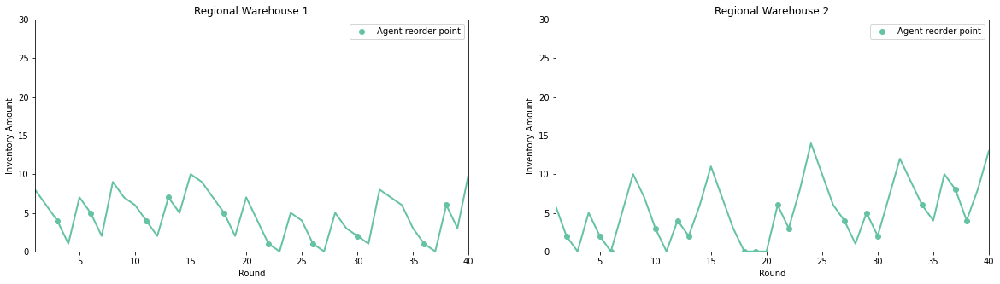

In [13]:
# Plots inventories of regional warehouses

reorder_marker = mlines.Line2D([],[], color='#66C2A5', marker='o', linestyle='None', label="Agent reorder point")
plt.rcParams["figure.figsize"] = (20, 5)

for rw_id in inventory_levels:
    plt.subplot(1, number_of_regional_warehouses, rw_id)
    plt.plot([0] + inventory_levels[rw_id], "-bo", markevery=convert_to_marker_pos([0] + actions[rw_id]), color="#66C2A5", linewidth=2)
    plt.legend(handles=[reorder_marker])
    plt.title("Regional Warehouse " + str(rw_id))
    plt.ylim(0, max_inventory_amount_regional_warehouses)
    plt.xlim(1, simulation_length)
    plt.ylabel("Inventory Amount")
    plt.xlabel("Round")
    
    # Print used data if True
    if False:
        print("RW", rw_id, "data:")
        print("Inventory:", inventory_levels[rw_id])
        print("Actions:", actions[rw_id])
        print("_"*100)

plt.show()

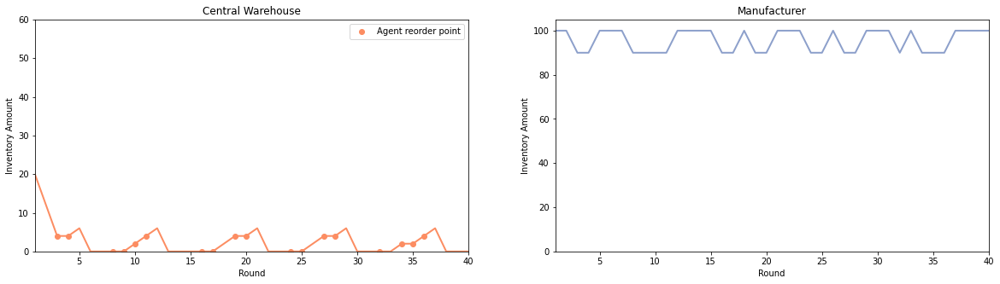

In [14]:
# Plots for CW and Manufacturer (Will only display if manufacturer is simulated)
if len(cw_inventory_level) != 0:
    # Plot for CW inventory with ordering points
    plt.rcParams["figure.figsize"] = (20, 5)
    plt.subplot(1, 2, 1)
    reorder_marker = mlines.Line2D([],[], color='#FC8D62', marker='o', linestyle='None', label="Agent reorder point")
    plt.plot([0] + cw_inventory_level, "-bo", color="#FC8D62", markevery=convert_to_marker_pos([0] + cw_actions), linewidth=2)
    plt.legend(handles=[reorder_marker])
    plt.title("Central Warehouse")
    plt.ylim(0, max_inventory_amount_central_warehouse)
    plt.xlim(1, simulation_length)
    plt.ylabel("Inventory Amount")
    plt.xlabel("Round")
    
    # Plot for manufacturer inventory
    plt.subplot(1, 2, 2)
    plt.plot([0] + manufacturer_inventory, color="#8DA0CB", linewidth=2)
    plt.title("Manufacturer")
    plt.ylim(0, env.simulation.get_manufacturer().get_inventory_limit()+5)
    plt.xlim(1, simulation_length)
    plt.ylabel("Inventory Amount")
    plt.xlabel("Round")
    plt.show()
    
    # Print used data if True
    if False:
        print("CW Inventory:", cw_inventory_level)
        print("CW Actions:", cw_actions)
        print("Manufacturer Inventrory:", manufacturer_inventory)

### 5. Create Logfile

In [15]:
if create_logfile:
    simulation_run_data = {}
    simulation_run_data["stats"] = env.evaluation_parameters()
    for rw_id in inventory_levels:
        simulation_run_data["regional_warehouse_" + str(rw_id)] = {}
        simulation_run_data["regional_warehouse_" + str(rw_id)]["inventory"] = inventory_levels[rw_id]
        simulation_run_data["regional_warehouse_" + str(rw_id)]["actions"] = actions[rw_id]
    
    if len(cw_inventory_level) != 0:
        simulation_run_data["central_warehouse"] = {}
        simulation_run_data["central_warehouse"]["inventory"] = str(cw_inventory_level) # Fix intc not compatiple with json (str for temp fix)
        simulation_run_data["central_warehouse"]["actions"] = str(cw_actions)
        
        simulation_run_data["manufacturer"] = {}
        simulation_run_data["manufacturer"]["inventory"] = manufacturer_inventory

    json_dict["simulation_run_data"] = simulation_run_data
    
    now = datetime.now()
    dt_string = now.strftime("%Y-%m-%d_%H-%M-%S")
    
    with open(logfile_location + "/logfile_" + dt_string + ".json", 'w') as f:
        options = jsbeautifier.default_options()
        options.indent_size = 4
        f.write(jsbeautifier.beautify(json.dumps(json_dict), options))
        print("Logfile was created")

Logfile was created
